In [11]:
import numpy as np
import pandas as pd
import folium
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


In [4]:
df = pd.read_csv('/content/Dataset .csv')

df.dropna(inplace=True)
df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 4401 entries, 0 to 4409
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         4401 non-null   int64  
 1   Restaurant Name       4401 non-null   object 
 2   Country Code          4401 non-null   int64  
 3   City                  4401 non-null   object 
 4   Address               4401 non-null   object 
 5   Locality              4401 non-null   object 
 6   Locality Verbose      4401 non-null   object 
 7   Longitude             4401 non-null   float64
 8   Latitude              4401 non-null   float64
 9   Cuisines              4401 non-null   object 
 10  Average Cost for two  4401 non-null   float64
 11  Currency              4401 non-null   object 
 12  Has Table booking     4401 non-null   object 
 13  Has Online delivery   4401 non-null   object 
 14  Is delivering now     4401 non-null   object 
 15  Switch to order menu  4401

In [5]:
df.drop(['Restaurant ID', 'Address', 'Locality Verbose', 'Currency', 'Has Table booking', 'Has Online delivery', 'Is delivering now', 'Switch to order menu', 'Rating color', 'Rating text', 'Country Code'], inplace=True, axis=1)
df.head(5)

,Restaurant Name,City,Locality,Longitude,Latitude,Cuisines,Average Cost for two,Price range,Aggregate rating,Votes
0,Le Petit Souffle,Makati City,"Century City Mall, Poblacion, Makati City",121.027535,14.565443,"French, Japanese, Desserts",1100.0,3.0,4.8,314.0
1,Izakaya Kikufuji,Makati City,"Little Tokyo, Legaspi Village, Makati City",121.014101,14.553708,Japanese,1200.0,3.0,4.5,591.0
2,Heat - Edsa Shangri-La,Mandaluyong City,"Edsa Shangri-La, Ortigas, Mandaluyong City",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",4000.0,4.0,4.4,270.0
3,Ooma,Mandaluyong City,"SM Megamall, Ortigas, Mandaluyong City",121.056475,14.585318,"Japanese, Sushi",1500.0,4.0,4.9,365.0
4,Sambo Kojin,Mandaluyong City,"SM Megamall, Ortigas, Mandaluyong City",121.057508,14.584450,"Japanese, Korean",1500.0,4.0,4.8,229.0


In [14]:
print(df.isnull().sum())

Restaurant Name         0
City                    0
Locality                0
Longitude               0
Latitude                0
Cuisines                0
Average Cost for two    0
Price range             0
Aggregate rating        0
Votes                   0
dtype: int64


In [6]:
# Calculate the average latitude and longitude
center_lat = df['Latitude'].mean()
center_lon = df['Longitude'].mean()

# Create the map, centered on the average coordinates, with a reasonable zoom level
restaurant_map = folium.Map(location=[center_lat, center_lon], zoom_start=1.5)

# Display the map (in Colab, this will show the map directly)
restaurant_map

In [7]:
# Loop through each restaurant in our DataFrame
for index, row in df.iterrows():
    # Create a popup message with the restaurant's name
    popup_text = f"{row['Restaurant Name']}<br>Rating: {row['Aggregate rating']}"

    # Add a marker to the map
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],  # Restaurant's coordinates
        popup=popup_text,  # Popup message
        icon=folium.Icon(color='blue') # You can change the color.
    ).add_to(restaurant_map)

# Display the map with markers
restaurant_map

In [8]:
def get_marker_color(rating):
    """
    Function to determine marker color based on rating.
    You can customize these ranges and colors as you like.
    """
    if rating >= 4.5:
        return 'darkgreen'  # Excellent
    elif rating >= 4.0:
        return 'green'      # Very Good
    elif rating >= 3.5:
        return 'lightgreen' # Good
    elif rating >= 3.0:
        return 'orange'     # Average
    else:
        return 'red'        # Below Average

# Create the map (if you haven't already)
restaurant_map_colored = folium.Map(location=[center_lat, center_lon], zoom_start=1)

# Loop through restaurants and add colored markers
for index, row in df.iterrows():
    popup_text = f"{row['Restaurant Name']}<br>Rating: {row['Aggregate rating']}"
    marker_color = get_marker_color(row['Aggregate rating']) # Get color based on rating

    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=popup_text,
        icon=folium.Icon(color=marker_color) # Set marker color here
    ).add_to(restaurant_map_colored)

# Display the colored map
restaurant_map_colored

In [9]:
# Select Longitude and Latitude columns as features for clustering
location_data = df[['Longitude', 'Latitude']].values

print(location_data[:5]) # Print the first 5 rows to see the format

[[121.027535  14.565443]
 [121.014101  14.553708]
 [121.056831  14.581404]
 [121.056475  14.585318]
 [121.057508  14.58445 ]]


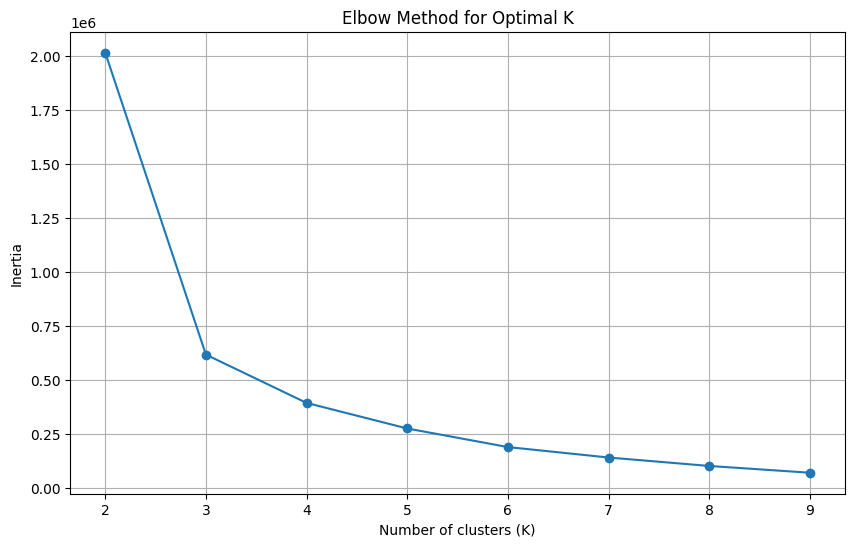

In [21]:
inertia = [] # List to store inertia values for different Ks
possible_clusters = range(2, 10) # Trying clusters from 2 to 10

for k in possible_clusters:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10) # Added n_init for recent sklearn versions
    kmeans.fit(location_data)
    inertia.append(kmeans.inertia_)

# Plot the Elbow graph
plt.figure(figsize=(10, 6))
plt.plot(possible_clusters, inertia, marker='o')
plt.title('Elbow Method for Optimal K')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Inertia')
plt.xticks(possible_clusters)
plt.grid(True)
plt.show()

In [25]:
# Run K-means clustering
kmeans = KMeans(n_clusters= 3, random_state=42, n_init=10) #  Added n_init for recent sklearn versions
df['Cluster'] = kmeans.fit_predict(location_data)

# Let's see how many restaurants are in each cluster
print("\nRestaurant counts per cluster:")
print(df['Cluster'].value_counts().sort_index())

# Display the first few rows with cluster labels
print("\nDataFrame with cluster labels:")
df.head(5)


Restaurant counts per cluster:
Cluster
0    3704
1     429
2     268
Name: count, dtype: int64

DataFrame with cluster labels:


,Restaurant Name,City,Locality,Longitude,Latitude,Cuisines,Average Cost for two,Price range,Aggregate rating,Votes,Cluster
0,Le Petit Souffle,Makati City,"Century City Mall, Poblacion, Makati City",121.027535,14.565443,"French, Japanese, Desserts",1100.0,3.0,4.8,314.0,0
1,Izakaya Kikufuji,Makati City,"Little Tokyo, Legaspi Village, Makati City",121.014101,14.553708,Japanese,1200.0,3.0,4.5,591.0,0
2,Heat - Edsa Shangri-La,Mandaluyong City,"Edsa Shangri-La, Ortigas, Mandaluyong City",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",4000.0,4.0,4.4,270.0,0
3,Ooma,Mandaluyong City,"SM Megamall, Ortigas, Mandaluyong City",121.056475,14.585318,"Japanese, Sushi",1500.0,4.0,4.9,365.0,0
4,Sambo Kojin,Mandaluyong City,"SM Megamall, Ortigas, Mandaluyong City",121.057508,14.584450,"Japanese, Korean",1500.0,4.0,4.8,229.0,0


In [28]:
# Define cluster colors
cluster_colors = ['blue', 'green', 'red']

# Create a new Folium map
restaurant_map_clusters = folium.Map(location=[center_lat, center_lon], zoom_start=10)

# Loop through each restaurant and add a marker with cluster color
for index, row in df.iterrows():
    popup_text = (f"Restaurant: {row['Restaurant Name']}<br>"
                  f"Rating: {row['Aggregate rating']}<br>"
                  f"Cluster: {row['Cluster']}")
    cluster_id = row['Cluster']
    marker_color = cluster_colors[cluster_id % len(cluster_colors)]

    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=popup_text,
        icon=folium.Icon(color=marker_color, icon='circle', prefix='fa')
    ).add_to(restaurant_map_clusters)

# Display the map
restaurant_map_clusters

In [29]:
# Analyze clusters - let's look at ratings and price range by cluster
cluster_analysis = df.groupby('Cluster').agg({
    'Aggregate rating': 'mean',       # Average rating per cluster
    'Price range': 'mean',           # Average price range per cluster
    'Restaurant Name': 'count'      # Number of restaurants in each cluster
}).rename(columns={'Restaurant Name': 'Restaurant Count'}) # Rename for clarity

print("Restaurant Cluster Analysis:")
print(cluster_analysis)

# Analyze cuisines by cluster (let's find top cuisines per cluster - this is a bit more complex)
def top_cuisines_in_cluster(cluster_label, top_n=5):
    cluster_restaurants = df[df['Cluster'] == cluster_label]
    cuisine_counts = cluster_restaurants['Cuisines'].str.split(', ', expand=True).stack().value_counts()
    return cuisine_counts.head(top_n)

print("\nTop Cuisines per Cluster:")
for cluster_label in sorted(df['Cluster'].unique()): # Iterate through clusters in order
    top_cuisines = top_cuisines_in_cluster(cluster_label)
    print(f"\nCluster {cluster_label} - Top Cuisines:")
    print(top_cuisines)

Restaurant Cluster Analysis:
         Aggregate rating  Price range  Restaurant Count
Cluster                                                 
0                2.902430     1.923326              3704
1                4.003263     2.058275               429
2                2.373881     2.134328               268

Top Cuisines per Cluster:

Cluster 0 - Top Cuisines:
North Indian    1617
Chinese         1088
Fast Food        759
Mughlai          413
Continental      397
Name: count, dtype: int64

Cluster 1 - Top Cuisines:
American    112
Seafood      59
Pizza        50
Sandwich     49
Burger       49
Name: count, dtype: int64

Cluster 2 - Top Cuisines:
North Indian    103
Chinese          59
Fast Food        31
Cafe             26
Bakery           26
Name: count, dtype: int64
